## ENGINE HEALTH

### Import necessary Library

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

#import tensorflow as tf
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
import xgboost as xgb

%config InlineBackend.figure_format = 'jpeg'
plt.rcParams["figure.figsize"]=(16,10)
plt.rcParams.update({'font.size':8})


### Import data and Analysis

In [2]:
df = pd.read_csv('engine_data.csv')
df.head()

,Engine rpm,Lub oil pressure,Fuel pressure,Coolant pressure,lub oil temp,Coolant temp,Engine Condition
0,700,2.493592,11.790927,3.178981,84.144163,81.632187,1
1,876,2.941606,16.193866,2.464504,77.640934,82.445724,0
2,520,2.961746,6.553147,1.064347,77.752266,79.645777,1
3,473,3.707835,19.510172,3.727455,74.129907,71.774629,1
4,619,5.672919,15.738871,2.052251,78.396989,87.000225,0


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19535 entries, 0 to 19534
Data columns (total 7 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Engine rpm        19535 non-null  int64  
 1   Lub oil pressure  19535 non-null  float64
 2   Fuel pressure     19535 non-null  float64
 3   Coolant pressure  19535 non-null  float64
 4   lub oil temp      19535 non-null  float64
 5   Coolant temp      19535 non-null  float64
 6   Engine Condition  19535 non-null  int64  
dtypes: float64(5), int64(2)
memory usage: 1.0 MB


In [4]:
df.describe()

,Engine rpm,Lub oil pressure,Fuel pressure,Coolant pressure,lub oil temp,Coolant temp,Engine Condition
count,19535.000000,19535.000000,19535.000000,19535.000000,19535.000000,19535.000000,19535.000000
mean,791.239263,3.303775,6.655615,2.335369,77.643420,78.427433,0.630509
std,267.611193,1.021643,2.761021,1.036382,3.110984,6.206749,0.482679
min,61.000000,0.003384,0.003187,0.002483,71.321974,61.673325,0.000000
25%,593.000000,2.518815,4.916886,1.600466,75.725990,73.895421,0.000000
50%,746.000000,3.162035,6.201720,2.166883,76.817350,78.346662,1.000000
75%,934.000000,4.055272,7.744973,2.848840,78.071691,82.915411,1.000000
max,2239.000000,7.265566,21.138326,7.478505,89.580796,195.527912,1.000000


In [5]:
df['Engine Condition'].value_counts()

1    12317
0     7218
Name: Engine Condition, dtype: int64

Here 

    '1' means ENGINE OK.
    
    '0' means ENGINE NG.

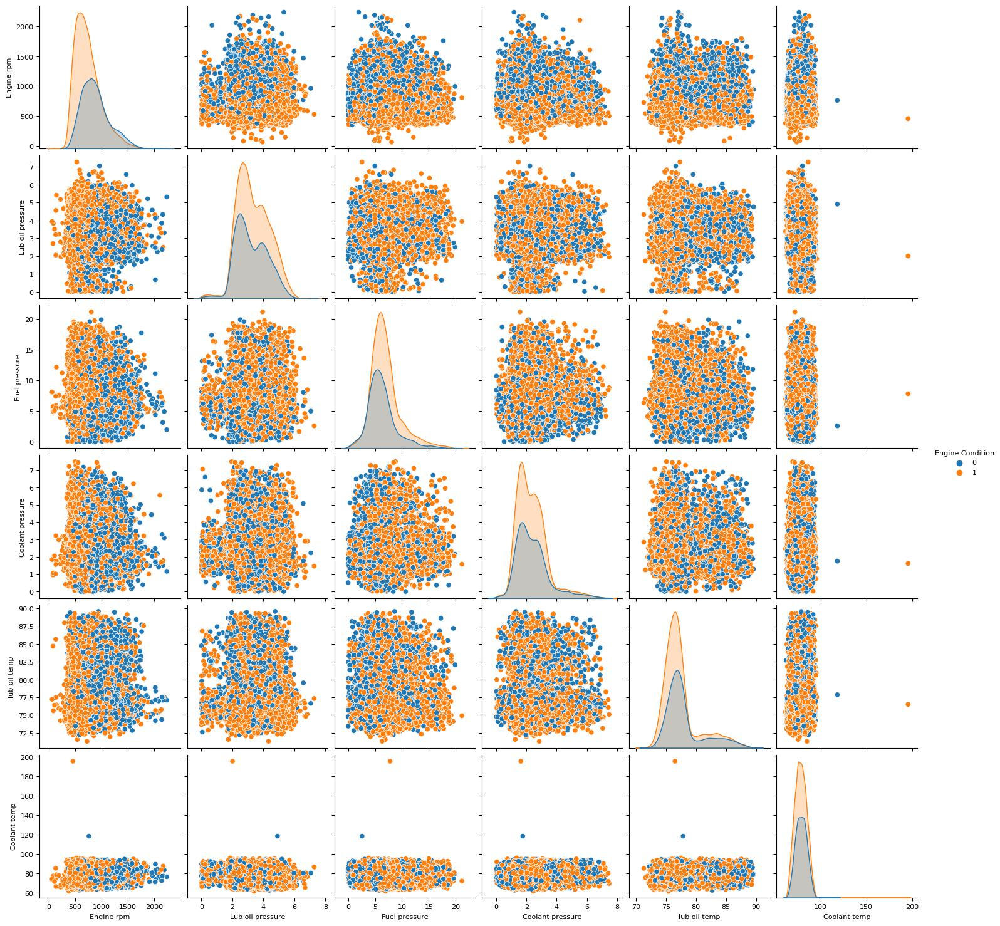

In [6]:
sns.pairplot(df, hue='Engine Condition')

  0%|                                                                                         | 0/1270 [00:00<…

C:\ProgramData\Anaconda3\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
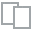
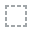
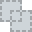
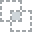
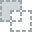
...
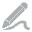
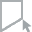
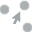
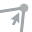
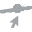

In [7]:
# Create EDA report
from dataprep.eda import create_report, create_db_report, create_diff_report

create_report(df)


In [6]:
# Check the corelation coefcients of various parameters of engine

corr_matrix = df.corr()
corr_matrix['Engine Condition'].sort_values(ascending=False)

Engine Condition    1.000000
Fuel pressure       0.116259
Lub oil pressure    0.060904
Coolant pressure   -0.024054
Coolant temp       -0.046326
lub oil temp       -0.093635
Engine rpm         -0.268201
Name: Engine Condition, dtype: float64

**`Inference`**
- Engine Condition has highest **positive** correlation of 0.12 with `Fuel Pressure`.
- Engine Condition has highest **negative** correlation of 0.12 with `Engine rpm`.

In [9]:
def plot_histograms(df):
    # List of parameters to plot
    parameters = ['Fuel pressure', 'Lub oil pressure', 'Coolant pressure', 
                  'Coolant temp', 'lub oil temp', 'Engine rpm']
    
    # Iterate through each parameter and create a histplot
    for param in parameters:
        plt.figure(figsize=(4,2))
        sns.histplot(df, x=df[param], hue='Engine Condition', kde=False)#, multiple="stack")
        plt.title(f'Histogram of {param} by Engine Condition')
        plt.xlabel(param)
        plt.ylabel('Frequency')
        plt.show()

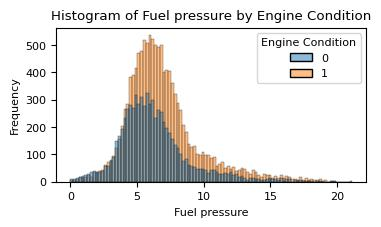

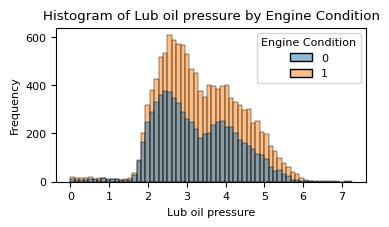

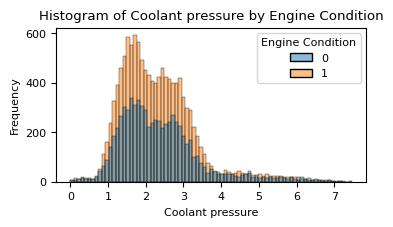

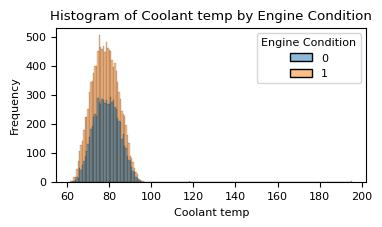

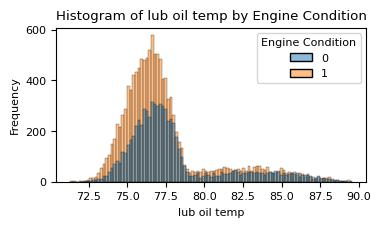

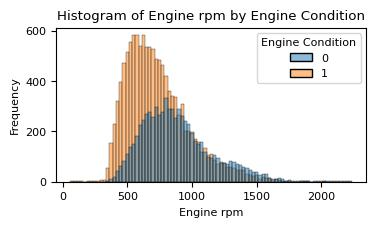

In [10]:
plot_histograms(df)

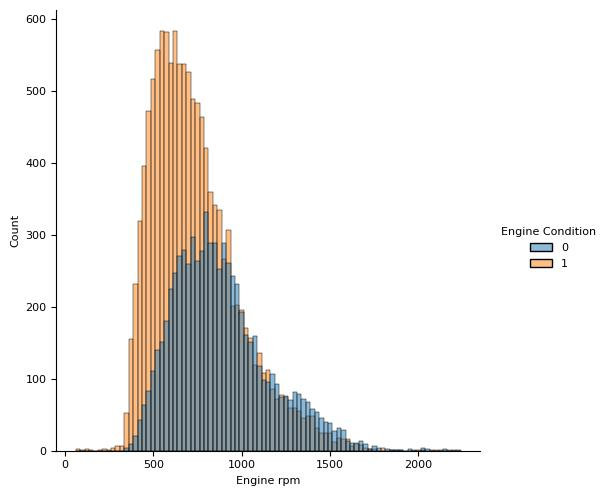

In [11]:
sns.displot(df, x=df["Engine rpm"], hue="Engine Condition")

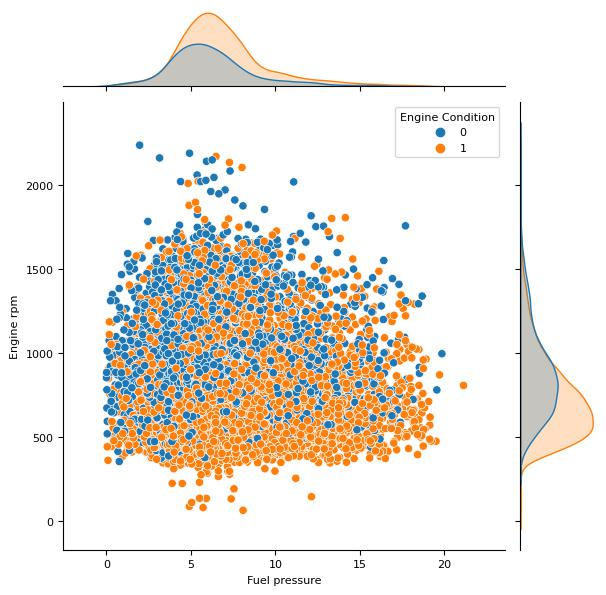

In [12]:
sns.jointplot(df,x='Fuel pressure', y='Engine rpm', hue='Engine Condition')

* Here we can see that lower values of Engine rpm & HIgher values of Fuel pressure are positive.

### Feature Engineering

In [7]:
# OIling system
df['oil_system'] = df['Lub oil pressure']*df['lub oil temp']

# Coolant system
df['coolant_system'] = df['Coolant pressure']*df['Coolant temp']

# Oil rpm
df['oil_rpm'] = df['lub oil temp']/df['Engine rpm']

# Coolant rpm
df['coolant_rpm'] = df['Coolant temp']/df['Engine rpm']

# Fuel rpm
df['fuel_rpm'] = df['Fuel pressure']/df['Engine rpm']

df.head()

,Engine rpm,Lub oil pressure,Fuel pressure,Coolant pressure,lub oil temp,Coolant temp,Engine Condition,oil_system,coolant_system,oil_rpm,coolant_rpm,fuel_rpm
0,700,2.493592,11.790927,3.178981,84.144163,81.632187,1,209.821196,259.507153,0.120206,0.116617,0.016844
1,876,2.941606,16.193866,2.464504,77.640934,82.445724,0,228.389032,203.187793,0.088631,0.094116,0.018486
2,520,2.961746,6.553147,1.064347,77.752266,79.645777,1,230.282429,84.770725,0.149524,0.153165,0.012602
3,473,3.707835,19.510172,3.727455,74.129907,71.774629,1,274.861445,267.536725,0.156723,0.151743,0.041248
4,619,5.672919,15.738871,2.052251,78.396989,87.000225,0,444.739735,178.546339,0.126651,0.140550,0.025426


In [8]:
corr_matrix = df.corr()
corr_matrix['Engine Condition'].sort_values(ascending=False)

Engine Condition    1.000000
oil_rpm             0.256342
coolant_rpm         0.252389
fuel_rpm            0.251021
Fuel pressure       0.116259
Lub oil pressure    0.060904
oil_system          0.047988
Coolant pressure   -0.024054
coolant_system     -0.032972
Coolant temp       -0.046326
lub oil temp       -0.093635
Engine rpm         -0.268201
Name: Engine Condition, dtype: float64

In [9]:
def plot_jointplot(df, parameters):
    for i in range(len(parameters)):
        # Create pairwise joint plot for given parametrs
        for j in range(i+1, len(parameters)):
            plt.figure(figsize=(4,2))
            sns.jointplot(df, x=parameters[i], y=parameters[j], hue='Engine Condition')
            plt.title(f'Jointplot of {parameters[i]} vs {parameters[i]} by Engine Condition')
            plt.xlabel(parameters[i])
            plt.ylabel(parameters[j])
            plt.show()

In [10]:
def plot_jointplot1(df, parameter_x, parameter_y):
    for i in range(len(parameter_x)):
        # Create pairwise joint plot for given parametrs
        for j in range(len(parameter_y)):
            plt.figure(figsize=(4,2))
            sns.jointplot(df, x=parameter_x[i], y=parameter_y[j], hue='Engine Condition')
            plt.title(f'Jointplot of {parameter_x[i]} vs {parameter_y[j]} by Engine Condition', fontsize=8)
            plt.xlabel(parameter_x[i])
            plt.ylabel(parameter_y[j])
            plt.subplots_adjust(top=0.95)
            plt.show()

<Figure size 400x200 with 0 Axes>

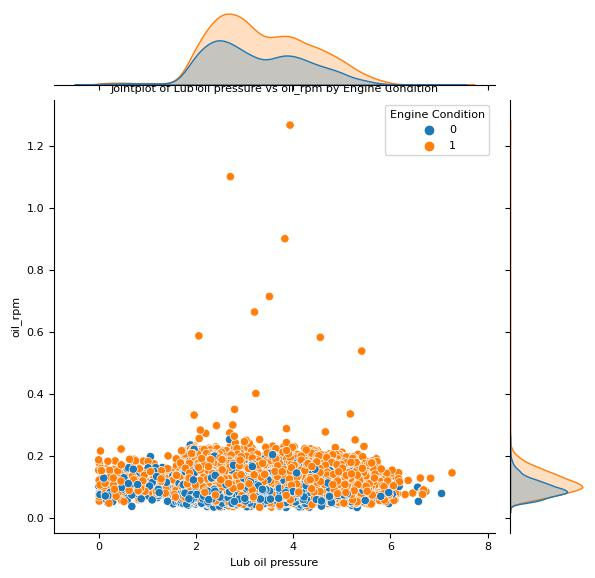

<Figure size 400x200 with 0 Axes>

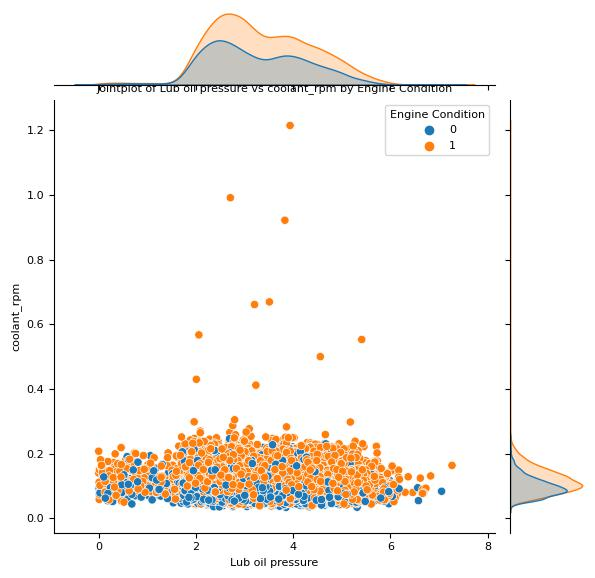

<Figure size 400x200 with 0 Axes>

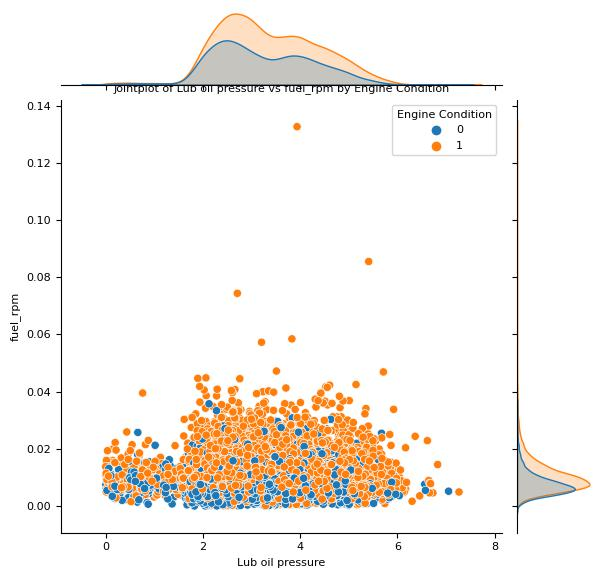

<Figure size 400x200 with 0 Axes>

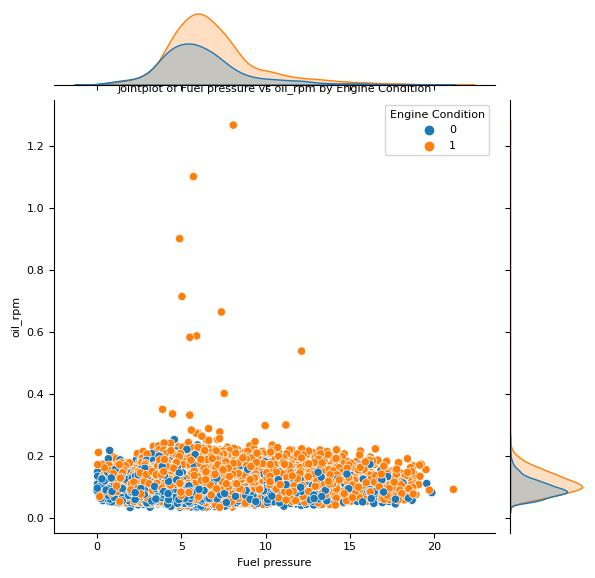

<Figure size 400x200 with 0 Axes>

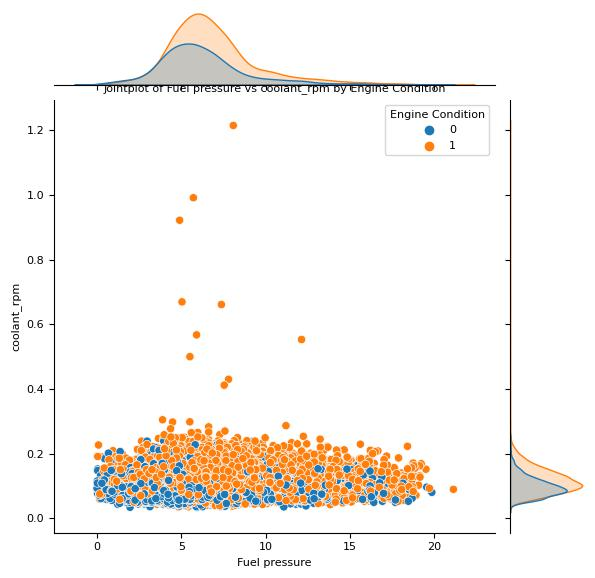

<Figure size 400x200 with 0 Axes>

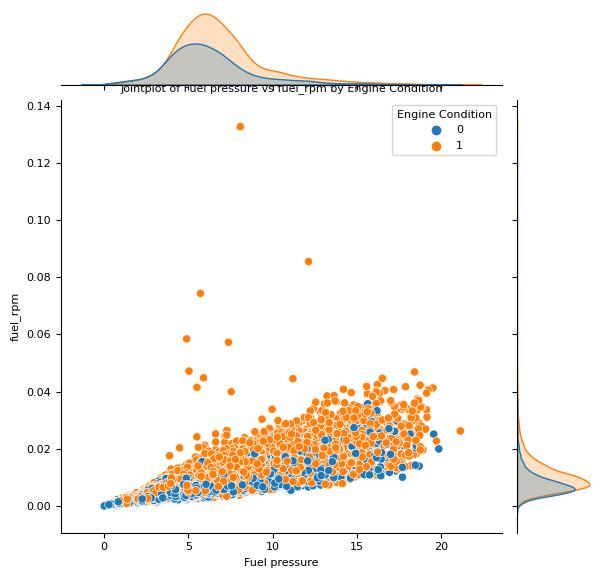

In [17]:
parameters = ['oil_rpm', 'coolant_rpm','fuel_rpm','Lub oil pressure','Fuel pressure']
parameter_x = ['Lub oil pressure','Fuel pressure']
parameter_y = ['oil_rpm', 'coolant_rpm','fuel_rpm']
plot_jointplot1(df, parameter_x, parameter_y)

* We can see that with increase in fuel_rpm, coolant_rpm & oil_rpm Engine condition is positive.

<Figure size 400x200 with 0 Axes>

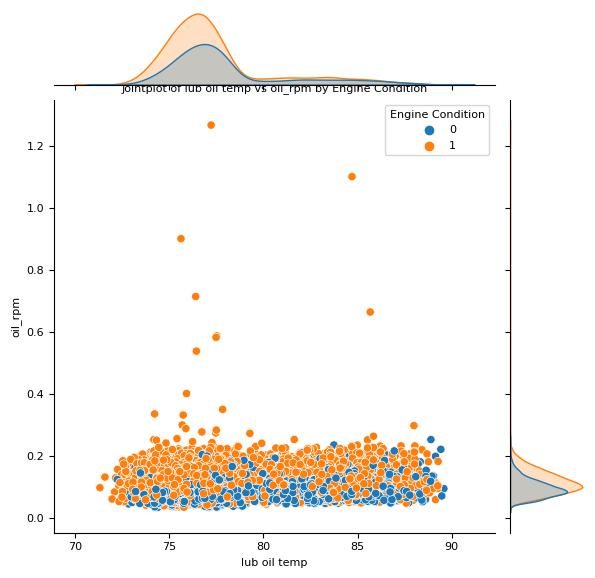

<Figure size 400x200 with 0 Axes>

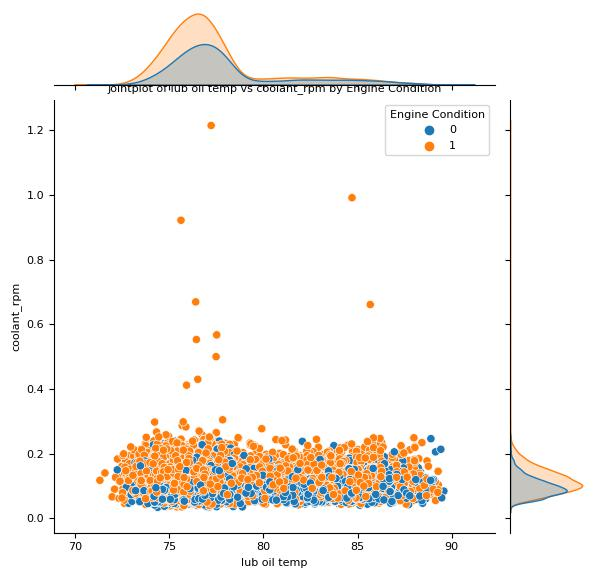

<Figure size 400x200 with 0 Axes>

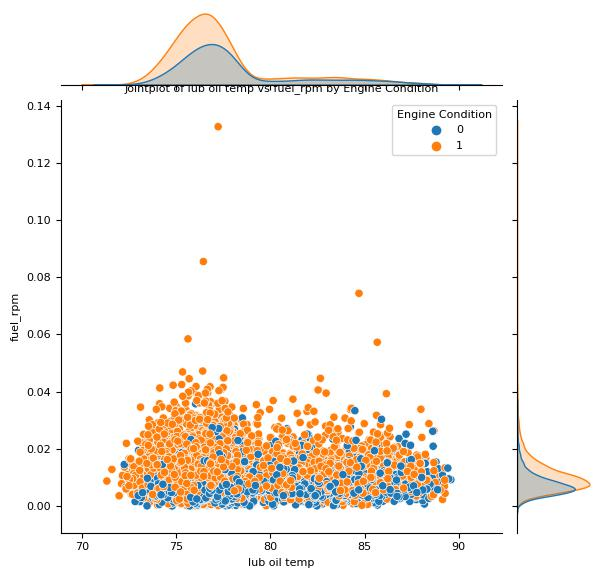

<Figure size 400x200 with 0 Axes>

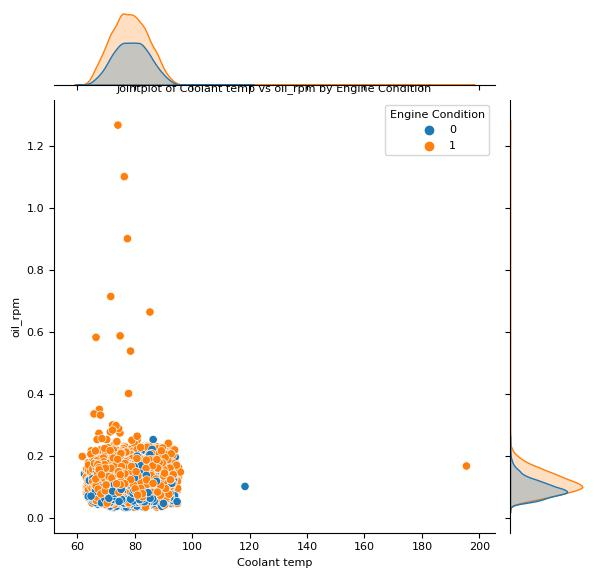

<Figure size 400x200 with 0 Axes>

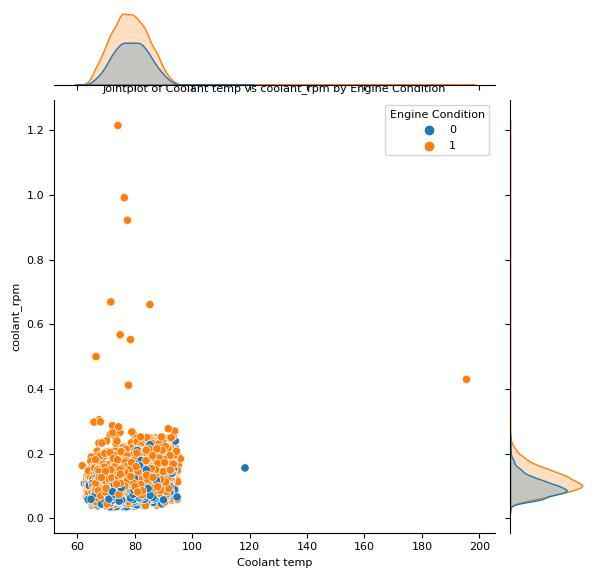

<Figure size 400x200 with 0 Axes>

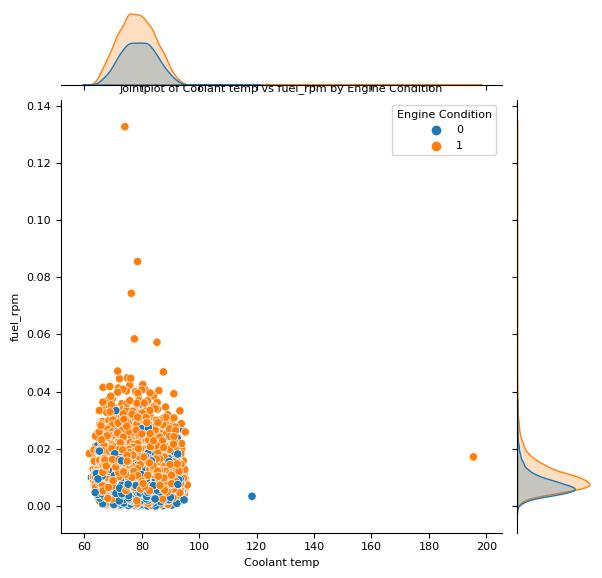

<Figure size 400x200 with 0 Axes>

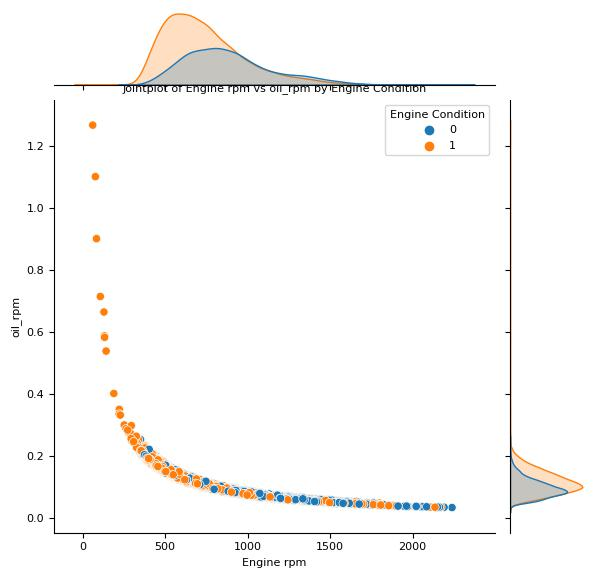

<Figure size 400x200 with 0 Axes>

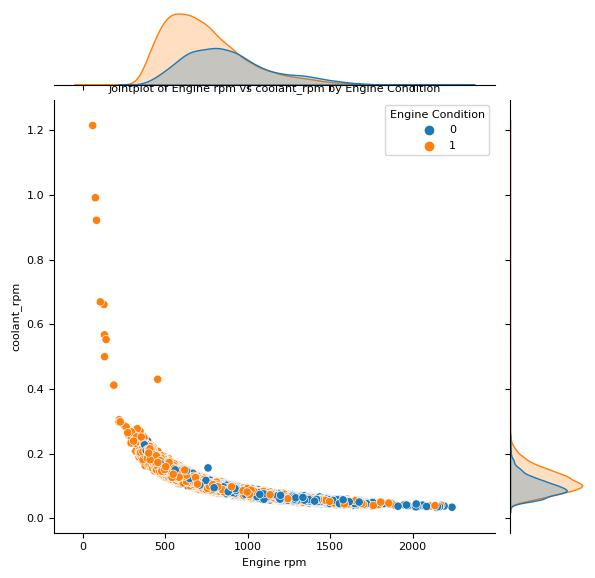

<Figure size 400x200 with 0 Axes>

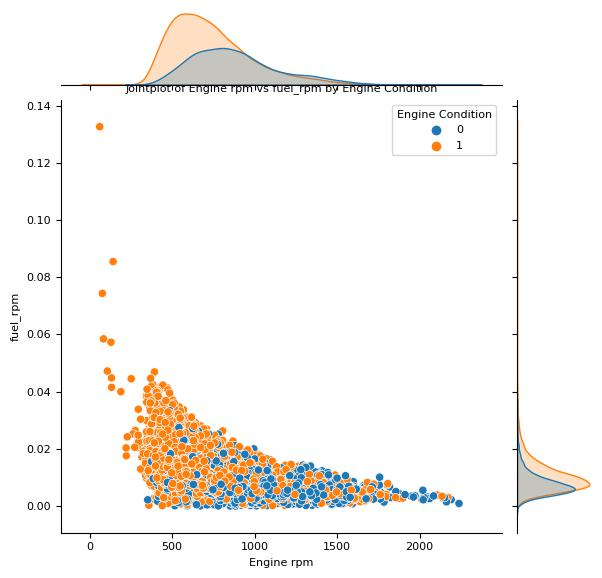

In [18]:
parameter_x = ['lub oil temp','Coolant temp','Engine rpm']
parameter_y = ['oil_rpm', 'coolant_rpm','fuel_rpm']
plot_jointplot1(df, parameter_x, parameter_y)

* Coolant Pressure, coolant temperature, lub oil temperature have mostly uniform distribution over entire range of values.
* With the increase of Engine rpm, condition of Engine becomes NG.

In [11]:
# Separating the features and target

df_features = df.drop('Engine Condition', axis = 1)
df_label = df['Engine Condition']

In [12]:
df_features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19535 entries, 0 to 19534
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Engine rpm        19535 non-null  int64  
 1   Lub oil pressure  19535 non-null  float64
 2   Fuel pressure     19535 non-null  float64
 3   Coolant pressure  19535 non-null  float64
 4   lub oil temp      19535 non-null  float64
 5   Coolant temp      19535 non-null  float64
 6   oil_system        19535 non-null  float64
 7   coolant_system    19535 non-null  float64
 8   oil_rpm           19535 non-null  float64
 9   coolant_rpm       19535 non-null  float64
 10  fuel_rpm          19535 non-null  float64
dtypes: float64(10), int64(1)
memory usage: 1.6 MB


### Splitting the data set

In [13]:
x_train, x_test, y_train, y_test = train_test_split(df_features, df_label, test_size=0.2, random_state=42)

In [14]:
print('Shape of X train data set: ', x_train.shape)
print('Shape of X test data set: ', x_test.shape,'\n')
print('Shape of Y train data set: ', y_train.shape)
print('Shape of Y test data set: ', y_test.shape)

Shape of X train data set:  (15628, 11)
Shape of X test data set:  (3907, 11) 

Shape of Y train data set:  (15628,)
Shape of Y test data set:  (3907,)


### Machine Learning models

In [15]:
# Function to Display consufion matrix

def display_confusion_matrix(y_true, y_pred, class_names=None):
    """
    Function to display confusion matrix and classification report for a classification model.
    Args:
    y_true (array-like): True labels.
    y_pred (array-like): Predicted labels.
    class_names (list): List of class names. Default is None.
    """
    # Generate confusion matrix
    cm = confusion_matrix(y_true, y_pred)

    # Plot confusion matrix
    plt.figure(figsize=(4,4))
    sns.heatmap(cm, annot=True, fmt='g', cmap=None, cbar=False, xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix')
    plt.show()

    # Print classification report
    print("Classification Report:")
    print(classification_report(y_true, y_pred, target_names=class_names))


#### Logistic Regression

In [15]:
lr = LogisticRegression(max_iter=5000)
lr.fit(x_train, y_train)

y_pred = lr.predict(x_test)

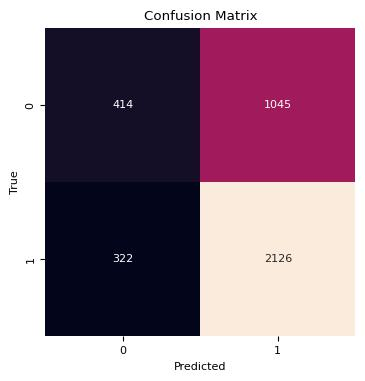

Classification Report:
              precision    recall  f1-score   support

           0       0.56      0.28      0.38      1459
           1       0.67      0.87      0.76      2448

    accuracy                           0.65      3907
   macro avg       0.62      0.58      0.57      3907
weighted avg       0.63      0.65      0.62      3907



In [16]:
display_confusion_matrix(y_test, y_pred, [str(label) for label in lr.classes_])

### Decision Tree

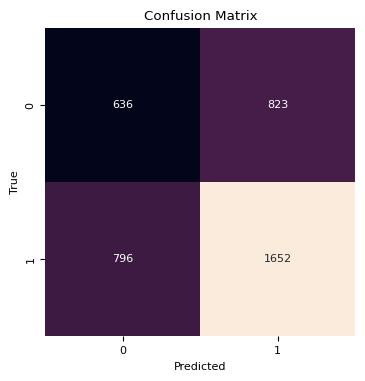

Classification Report:
              precision    recall  f1-score   support

           0       0.44      0.44      0.44      1459
           1       0.67      0.67      0.67      2448

    accuracy                           0.59      3907
   macro avg       0.56      0.56      0.56      3907
weighted avg       0.58      0.59      0.58      3907



In [17]:
dt = DecisionTreeClassifier()
dt.fit(x_train,y_train)

y_pred = dt.predict(x_test)
display_confusion_matrix(y_test, y_pred, [str(label) for label in dt.classes_])

### Random forest

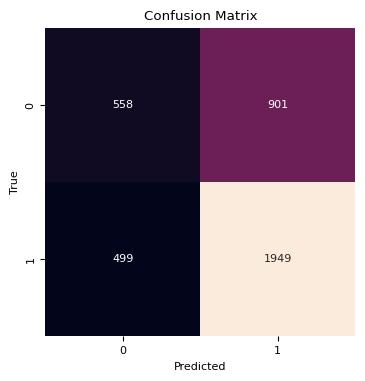

Classification Report:
              precision    recall  f1-score   support

           0       0.53      0.38      0.44      1459
           1       0.68      0.80      0.74      2448

    accuracy                           0.64      3907
   macro avg       0.61      0.59      0.59      3907
weighted avg       0.63      0.64      0.63      3907



In [18]:
rf = RandomForestClassifier()
rf.fit(x_train,y_train)

y_pred = rf.predict(x_test)
display_confusion_matrix(y_test, y_pred, [str(label) for label in rf.classes_])

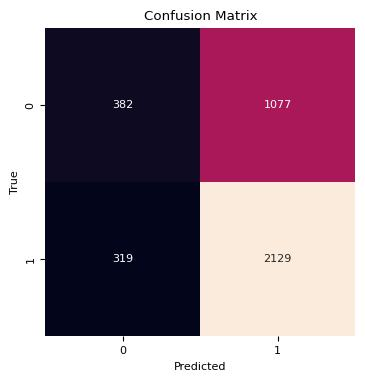

Classification Report:
              precision    recall  f1-score   support

           0       0.54      0.26      0.35      1459
           1       0.66      0.87      0.75      2448

    accuracy                           0.64      3907
   macro avg       0.60      0.57      0.55      3907
weighted avg       0.62      0.64      0.60      3907



In [19]:
# Adaboost logistic regression
from sklearn.ensemble import AdaBoostClassifier
ada_lr = AdaBoostClassifier(estimator=lr, n_estimators=50, random_state=42)
ada_lr.fit(x_train, y_train)
y_pred = ada_lr.predict(x_test)
display_confusion_matrix(y_test, y_pred, [str(label) for label in ada_lr.classes_])

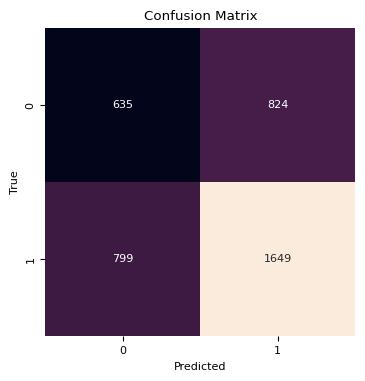

Classification Report:
              precision    recall  f1-score   support

           0       0.44      0.44      0.44      1459
           1       0.67      0.67      0.67      2448

    accuracy                           0.58      3907
   macro avg       0.55      0.55      0.55      3907
weighted avg       0.58      0.58      0.58      3907



In [29]:
# Adaboost Decision tree classifier
ada_tree = AdaBoostClassifier(estimator=dt, n_estimators=50, random_state=42)
ada_tree.fit(x_train, y_train)
y_pred = ada_tree.predict(x_test)
display_confusion_matrix(y_test, y_pred, [str(label) for label in ada_tree.classes_])

In [20]:
# Perform grid search with cross validation for dec tree
param_grid = {'max_depth': [3,5,7,10,None], 'min_samples_split': [2,5,7,10],
              'min_samples_leaf': [1,3,4,5], 'criterion': ['gini','entropy']}

grid_search = GridSearchCV(dt, param_grid, cv=5, n_jobs=-1)
grid_search.fit(x_train, y_train)

print(f'Best parameters: {grid_search.best_params_}')

Best parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 2}


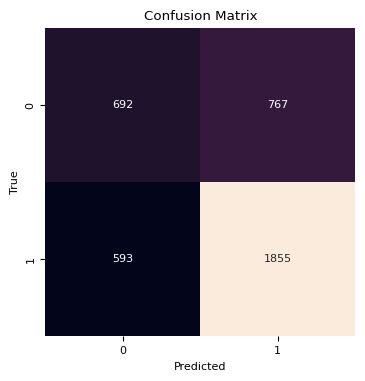

Classification Report:
              precision    recall  f1-score   support

           0       0.54      0.47      0.50      1459
           1       0.71      0.76      0.73      2448

    accuracy                           0.65      3907
   macro avg       0.62      0.62      0.62      3907
weighted avg       0.64      0.65      0.65      3907



In [21]:
# TRain decision tree with best parameters
best_params = {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 2}
dt_cv = DecisionTreeClassifier(**best_params)

dt_cv.fit(x_train,y_train)
y_pred = dt_cv.predict(x_test)

display_confusion_matrix(y_test, y_pred, [str(label) for label in dt_cv.classes_])


In [22]:
# Perform grid search with cross validation for random forest
param_grid = {'max_depth': [3,5,7,10,None], 'min_samples_split': [2,5,7,10],
              'min_samples_leaf': [1,3,4,5], 'criterion': ['gini','entropy']}

grid_search = GridSearchCV(rf, param_grid, cv=5, n_jobs=-1)
grid_search.fit(x_train, y_train)

print(f'Best parameters: {grid_search.best_params_}')

Best parameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_leaf': 5, 'min_samples_split': 5}


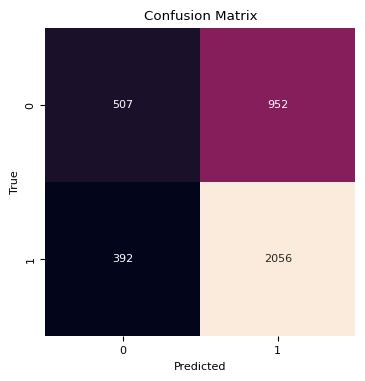

Classification Report:
              precision    recall  f1-score   support

           0       0.56      0.35      0.43      1459
           1       0.68      0.84      0.75      2448

    accuracy                           0.66      3907
   macro avg       0.62      0.59      0.59      3907
weighted avg       0.64      0.66      0.63      3907



In [23]:
# TRain Random forest with best parameters
best_params = {'criterion': 'entropy', 'max_depth': 10, 'min_samples_leaf': 3, 'min_samples_split': 10}
rf_cv = RandomForestClassifier(**best_params)

rf_cv.fit(x_train,y_train)
y_pred = rf_cv.predict(x_test)

display_confusion_matrix(y_test, y_pred, [str(label) for label in rf_cv.classes_])


### Boosted Algorithm

In [16]:
import xgboost as xgb
import lightgbm as lgb
from catboost import CatBoostClassifier

In [53]:
# Function to train data using xgboost, lightgbm, catboost algorithm

def train_boost(x_train, x_test, y_train, y_test):
    #Initialise classification models
    models = {'XGBoost': xgb.XGBClassifier(objective='binary:logistic'),
              'LightGBM': lgb.LGBMClassifier(),
              'CatBoost': CatBoostClassifier(iterations=200, depth=6, learning_rate=0.1, loss_function='Logloss', verbose=1)
             }
    # Train and evaluate models
    evaluation_results = {}

    for model_name, model in models.items():
        print(f'Training {model_name}..')
        model.fit(x_train, y_train)
        y_pred = model.predict(x_test)

        # Confusion matrix
        cm = confusion_matrix(y_test, y_pred)
        # Classification report
        cr = classification_report(y_test, y_pred, output_dict=True)

        evaluation_results[model_name] = {'CONFUSION MATRIX': cm, 'CLASSIFICATION REPORT': cr}

    return evaluation_results

In [54]:
evaluation_results=train_boost(x_train, x_test, y_train, y_test)

Training XGBoost..
Training LightGBM..
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 9869, number of negative: 5759
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000335 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2805
[LightGBM] [Info] Number of data points in the train set: 15628, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.631495 -> initscore=0.538635
[LightGBM] [Info] Start training from score 0.538635
Training CatBoost..
0:	learn: 0.6757762	total: 6.83ms	remaining: 1.36s
1:	learn: 0.6618519	total: 13.2ms	remaining: 1.31s
2:	learn: 0.6502400	total: 19.2ms	remaining: 1.26s
3:	learn: 0.6401438	total: 26.3ms	remaining: 1.29s
4:	learn: 0.6322708	total: 32.7ms	remaining: 1.27s
5:	learn: 0.6258574	total: 39.4ms	remaining: 1.27s
6:	learn: 0.6207694	total: 45.7ms	remaining: 1.26s
7:	learn: 0.61

In [55]:
evaluation_results

{'XGBoost': {'CONFUSION MATRIX': array([[ 544,  915],
         [ 466, 1982]], dtype=int64),
  'CLASSIFICATION REPORT': {'0': {'precision': 0.5386138613861386,
    'recall': 0.3728581220013708,
    'f1-score': 0.44066423653300935,
    'support': 1459},
   '1': {'precision': 0.6841560234725578,
    'recall': 0.809640522875817,
    'f1-score': 0.7416276894293733,
    'support': 2448},
   'accuracy': 0.6465318658817507,
   'macro avg': {'precision': 0.6113849424293483,
    'recall': 0.591249322438594,
    'f1-score': 0.5911459629811913,
    'support': 3907},
   'weighted avg': {'precision': 0.6298058789923721,
    'recall': 0.6465318658817507,
    'f1-score': 0.6292382146979182,
    'support': 3907}}},
 'LightGBM': {'CONFUSION MATRIX': array([[ 539,  920],
         [ 442, 2006]], dtype=int64),
  'CLASSIFICATION REPORT': {'0': {'precision': 0.5494393476044852,
    'recall': 0.3694311172035641,
    'f1-score': 0.4418032786885246,
    'support': 1459},
   '1': {'precision': 0.6855775803144224

In [51]:
def display_boost_classification(evaluation_results):
   
    for model_name, metrics in evaluation_results.items():
        print(f'\nResuls for{model_name}:')
        
        # Display confusion matrix
        print('Confusion Matrix:')
        cm = metrics['CONFUSION MATRIX']
        plt.figure(figsize=(4,4))
        sns.heatmap(cm, annot=True, cbar=False, cmap='Blues')
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.show()
        
        # Display Classification report
        print("\nClassification Report:")
        cr = metrics['CLASSIFICATION REPORT']
        print("Precision, Recall, F1-Score, and Accuracy for each class:")
        print(cr)


Resuls forXGBoost:
Confusion Matrix:


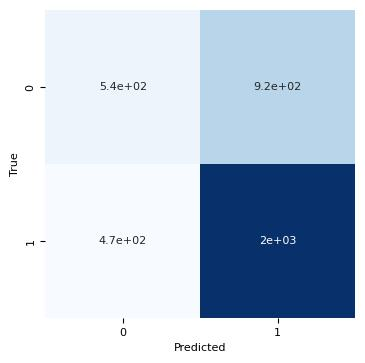


Classification Report:
Precision, Recall, F1-Score, and Accuracy for each class:
{'0': {'precision': 0.5386138613861386, 'recall': 0.3728581220013708, 'f1-score': 0.44066423653300935, 'support': 1459}, '1': {'precision': 0.6841560234725578, 'recall': 0.809640522875817, 'f1-score': 0.7416276894293733, 'support': 2448}, 'accuracy': 0.6465318658817507, 'macro avg': {'precision': 0.6113849424293483, 'recall': 0.591249322438594, 'f1-score': 0.5911459629811913, 'support': 3907}, 'weighted avg': {'precision': 0.6298058789923721, 'recall': 0.6465318658817507, 'f1-score': 0.6292382146979182, 'support': 3907}}

Resuls forLightGBM:
Confusion Matrix:


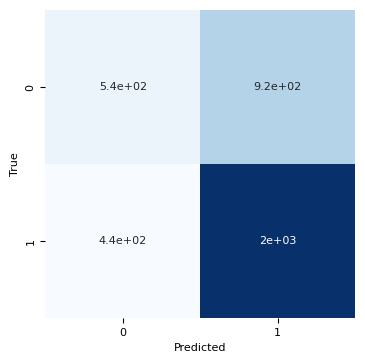


Classification Report:
Precision, Recall, F1-Score, and Accuracy for each class:
{'0': {'precision': 0.5494393476044852, 'recall': 0.3694311172035641, 'f1-score': 0.4418032786885246, 'support': 1459}, '1': {'precision': 0.6855775803144224, 'recall': 0.8194444444444444, 'f1-score': 0.7465574990695942, 'support': 2448}, 'accuracy': 0.6513949321730228, 'macro avg': {'precision': 0.6175084639594538, 'recall': 0.5944377808240042, 'f1-score': 0.5941803888790594, 'support': 3907}, 'weighted avg': {'precision': 0.634739166819721, 'recall': 0.6513949321730228, 'f1-score': 0.6327524293137763, 'support': 3907}}

Resuls forCatBoost:
Confusion Matrix:


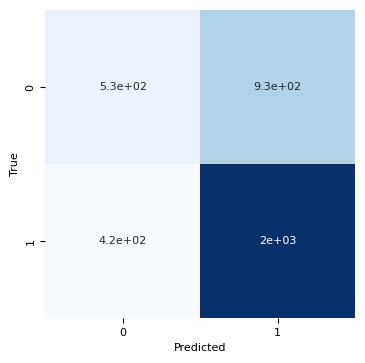


Classification Report:
Precision, Recall, F1-Score, and Accuracy for each class:
{'0': {'precision': 0.5571878279118573, 'recall': 0.36394790952707334, 'f1-score': 0.44029850746268656, 'support': 1459}, '1': {'precision': 0.6858496953283684, 'recall': 0.8276143790849673, 'f1-score': 0.7500925583117364, 'support': 2448}, 'accuracy': 0.6544663424622472, 'macro avg': {'precision': 0.6215187616201128, 'recall': 0.5957811443060204, 'f1-score': 0.5951955328872115, 'support': 3907}, 'weighted avg': {'precision': 0.6378031981282942, 'recall': 0.6544663424622472, 'f1-score': 0.6344054530676198, 'support': 3907}}


In [52]:
display_boost_classification(evaluation_results)

In [65]:
from sklearn.metrics import mean_squared_error
# Initialize LightGBM regressor
lightgb = lgb.LGBMClassifier()

# Train the model
lightgb.fit(x_train, y_train)

# Make predictions and evaluate performance
y_pred = lightgb.predict(x_test)
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 9869, number of negative: 5759
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000604 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2805
[LightGBM] [Info] Number of data points in the train set: 15628, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.631495 -> initscore=0.538635
[LightGBM] [Info] Start training from score 0.538635
Mean Squared Error: 0.3486050678269772


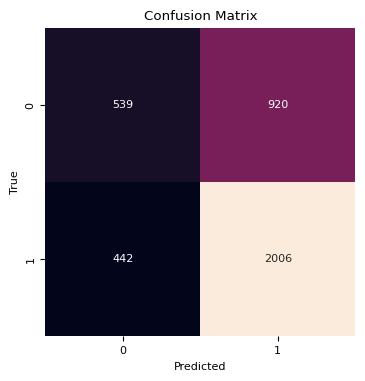

Classification Report:
              precision    recall  f1-score   support

           0       0.55      0.37      0.44      1459
           1       0.69      0.82      0.75      2448

    accuracy                           0.65      3907
   macro avg       0.62      0.59      0.59      3907
weighted avg       0.63      0.65      0.63      3907



In [66]:
display_confusion_matrix(y_test, y_pred, [str(label) for label in lightgb.classes_])

In [67]:

# Initialize LightGBM regressor
xgbclassifier = xgb.XGBClassifier()

# Train the model
xgbclassifier.fit(x_train, y_train)

# Make predictions and evaluate performance
y_pred = xgbclassifier.predict(x_test)
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')

Mean Squared Error: 0.3534681341182493


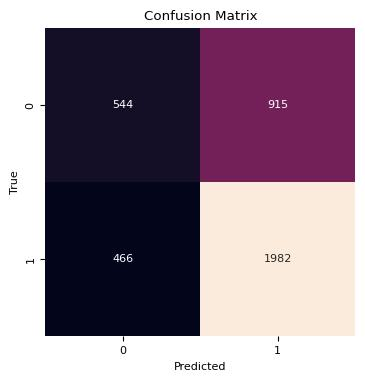

Classification Report:
              precision    recall  f1-score   support

           0       0.54      0.37      0.44      1459
           1       0.68      0.81      0.74      2448

    accuracy                           0.65      3907
   macro avg       0.61      0.59      0.59      3907
weighted avg       0.63      0.65      0.63      3907



In [68]:
display_confusion_matrix(y_test, y_pred, [str(label) for label in xgbclassifier.classes_])

In [71]:

# Initialize LightGBM regressor
catclassifier = CatBoostClassifier(iterations=200, depth=8, learning_rate=0.01, loss_function='Logloss', verbose=1)

# Train the model
catclassifier.fit(x_train, y_train)

# Make predictions and evaluate performance
y_pred = catclassifier.predict(x_test)
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')

0:	learn: 0.6912110	total: 23.1ms	remaining: 4.61s
1:	learn: 0.6892671	total: 38.1ms	remaining: 3.78s
2:	learn: 0.6872802	total: 52.2ms	remaining: 3.43s
3:	learn: 0.6852993	total: 63.7ms	remaining: 3.12s
4:	learn: 0.6834823	total: 75.6ms	remaining: 2.95s
5:	learn: 0.6817951	total: 87.6ms	remaining: 2.83s
6:	learn: 0.6799737	total: 99.5ms	remaining: 2.74s
7:	learn: 0.6782085	total: 111ms	remaining: 2.66s
8:	learn: 0.6764375	total: 122ms	remaining: 2.59s
9:	learn: 0.6748392	total: 133ms	remaining: 2.53s
10:	learn: 0.6732829	total: 144ms	remaining: 2.47s
11:	learn: 0.6717752	total: 154ms	remaining: 2.42s
12:	learn: 0.6702336	total: 165ms	remaining: 2.38s
13:	learn: 0.6686761	total: 176ms	remaining: 2.34s
14:	learn: 0.6672155	total: 187ms	remaining: 2.31s
15:	learn: 0.6658037	total: 199ms	remaining: 2.28s
16:	learn: 0.6643799	total: 212ms	remaining: 2.28s
17:	learn: 0.6629784	total: 224ms	remaining: 2.26s
18:	learn: 0.6615731	total: 235ms	remaining: 2.23s
19:	learn: 0.6601327	total: 247ms	

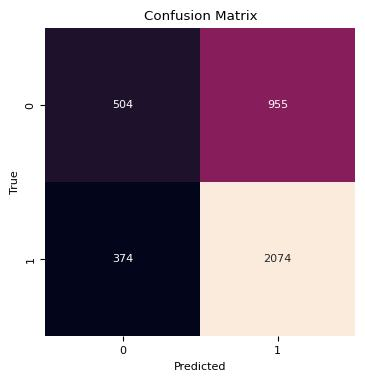

Classification Report:
              precision    recall  f1-score   support

           0       0.57      0.35      0.43      1459
           1       0.68      0.85      0.76      2448

    accuracy                           0.66      3907
   macro avg       0.63      0.60      0.59      3907
weighted avg       0.64      0.66      0.64      3907



In [72]:
display_confusion_matrix(y_test, y_pred, [str(label) for label in catclassifier.classes_])

In [75]:
# Define the parameter grid
param_grid = {
    'iterations': [50, 100, 200],
    'learning_rate': [0.01, 0.05, 0.1],
    'depth': [3, 5, 7],
    'l2_leaf_reg': [1, 3, 5]  # Hyperparameter specific to CatBoost
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=catclassifier, param_grid=param_grid, 
                           scoring='neg_mean_squared_error', cv=3, verbose=2)

# Fit the grid search to the data
grid_search.fit(x_train, y_train)

# Get the best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Train a new model with the best hyperparameters
best_model = grid_search.best_estimator_

# Make predictions with the best model
y_pred_best = best_model.predict(x_test)
mse_best = mean_squared_error(y_test, y_pred_best)
print(f'Mean Squared Error after tuning: {mse_best}')


Fitting 3 folds for each of 81 candidates, totalling 243 fits
0:	learn: 0.6917260	total: 1.67ms	remaining: 81.6ms
1:	learn: 0.6902329	total: 3.1ms	remaining: 74.3ms
2:	learn: 0.6888328	total: 4.47ms	remaining: 70ms
3:	learn: 0.6874824	total: 5.95ms	remaining: 68.5ms
4:	learn: 0.6860913	total: 7.78ms	remaining: 70ms
5:	learn: 0.6847535	total: 10.5ms	remaining: 77.1ms
6:	learn: 0.6834054	total: 11.8ms	remaining: 72.3ms
7:	learn: 0.6820969	total: 13ms	remaining: 68.3ms
8:	learn: 0.6807591	total: 14.3ms	remaining: 65.2ms
9:	learn: 0.6796100	total: 15.6ms	remaining: 62.4ms
10:	learn: 0.6783269	total: 16.8ms	remaining: 59.6ms
11:	learn: 0.6771448	total: 18ms	remaining: 57.2ms
12:	learn: 0.6759373	total: 19.4ms	remaining: 55.1ms
13:	learn: 0.6748097	total: 20.6ms	remaining: 52.9ms
14:	learn: 0.6736537	total: 21.9ms	remaining: 51ms
15:	learn: 0.6725366	total: 23.2ms	remaining: 49.3ms
16:	learn: 0.6713587	total: 24.5ms	remaining: 47.5ms
17:	learn: 0.6702578	total: 26ms	remaining: 46.2ms
18:	lea

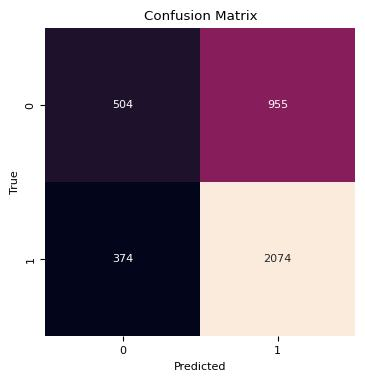

Classification Report:
              precision    recall  f1-score   support

           0       0.57      0.35      0.43      1459
           1       0.68      0.85      0.76      2448

    accuracy                           0.66      3907
   macro avg       0.63      0.60      0.59      3907
weighted avg       0.64      0.66      0.64      3907



In [76]:
display_confusion_matrix(y_test, y_pred, [str(i) for i in best_model.classes_])

In [78]:
# Define the parameter grid
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.3],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 0.9, 1.0],
    'num_leaves': [31, 50, 100]  # Hyperparameter specific to LightGBM
}

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=lightgb, param_grid=param_grid, 
                           scoring='neg_mean_squared_error', cv=3, verbose=1)

# Fit the grid search to the data
grid_search.fit(x_train, y_train)

# Get the best hyperparameters
print("Best hyperparameters:", grid_search.best_params_)

# Train a new model with the best hyperparameters
best_model = grid_search.best_estimator_

# Make predictions with the best model
y_pred_best = best_model.predict(x_test)
mse_best = mean_squared_error(y_test, y_pred_best)
print(f'Mean Squared Error after tuning: {mse_best}')


Fitting 3 folds for each of 243 candidates, totalling 729 fits
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 6579, number of negative: 3839
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000613 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2805
[LightGBM] [Info] Number of data points in the train set: 10418, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.631503 -> initscore=0.538671
[LightGBM] [Info] Start training from score 0.538671
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 6579, number of negative: 3840
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000230 seconds.
You can set `force_col_wise=true` to remove the ov

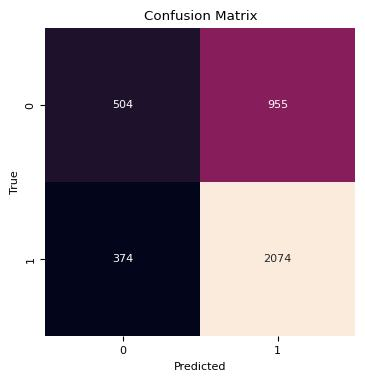

Classification Report:
              precision    recall  f1-score   support

           0       0.57      0.35      0.43      1459
           1       0.68      0.85      0.76      2448

    accuracy                           0.66      3907
   macro avg       0.63      0.60      0.59      3907
weighted avg       0.64      0.66      0.64      3907



In [79]:
display_confusion_matrix(y_test, y_pred, [str(i) for i in best_model.classes_])

In [18]:
# Using standaradization data
# Create a pipeline to automate data processing
engine_pipe = Pipeline([('std_scaler',StandardScaler())])

engine_data_prep = engine_pipe.fit_transform(df_features.values)
engine_data_prep


array([[-0.34094836, -0.7930403 ,  1.85998007, ...,  0.28361326,
         0.15814015,  1.41320269],
       [ 0.31673902, -0.35450592,  3.45469863, ..., -0.53743851,
        -0.41321638,  1.72433495],
       [-1.01358319, -0.33479242, -0.03711351, ...,  1.04597262,
         1.08616176,  0.60940056],
       ...,
       [-0.40073813, -0.61709112, -0.62595834, ...,  0.07923813,
         0.40207716, -0.41353712],
       [-0.3558958 , -0.20517651,  0.59262214, ...,  0.0413761 ,
        -0.11698993,  0.47890467],
       [-1.07337295,  0.46149476, -0.97543781, ...,  1.0565197 ,
         1.24870613, -0.28879766]])

In [19]:
# Split the prepared data
X_train, X_test, Y_train, Y_test = train_test_split(engine_data_prep, df_label, test_size=0.2, random_state=42)

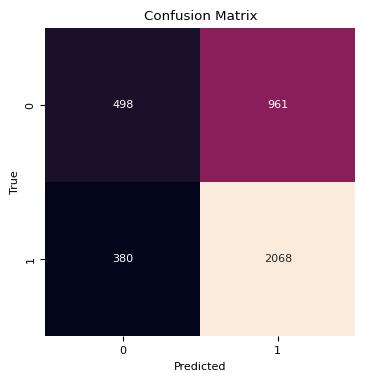

Classification Report:
              precision    recall  f1-score   support

           0       0.57      0.34      0.43      1459
           1       0.68      0.84      0.76      2448

    accuracy                           0.66      3907
   macro avg       0.62      0.59      0.59      3907
weighted avg       0.64      0.66      0.63      3907



In [24]:
lr = LogisticRegression()
lr.fit(X_train, Y_train)
Y_pred = lr.predict(X_test)
display_confusion_matrix(Y_test, Y_pred, [str(i) for i in lr.classes_])

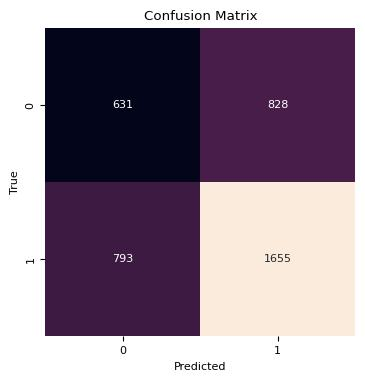

Classification Report:
              precision    recall  f1-score   support

           0       0.44      0.43      0.44      1459
           1       0.67      0.68      0.67      2448

    accuracy                           0.59      3907
   macro avg       0.55      0.55      0.55      3907
weighted avg       0.58      0.59      0.58      3907



In [26]:
dt = DecisionTreeClassifier()
dt.fit(X_train,Y_train)

Y_pred = dt.predict(X_test)
display_confusion_matrix(Y_test, Y_pred, [str(label) for label in dt.classes_])

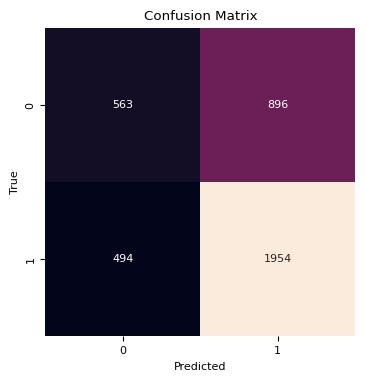

Classification Report:
              precision    recall  f1-score   support

           0       0.53      0.39      0.45      1459
           1       0.69      0.80      0.74      2448

    accuracy                           0.64      3907
   macro avg       0.61      0.59      0.59      3907
weighted avg       0.63      0.64      0.63      3907



In [28]:
rf = RandomForestClassifier()
rf.fit(X_train,Y_train)

Y_pred = rf.predict(X_test)
display_confusion_matrix(Y_test, Y_pred, [str(label) for label in rf.classes_])

In [ ]:
# Perform grid search with cross validation for dec tree
param_grid = {'max_depth': [3,5,7,10,None], 'min_samples_split': [2,5,7,10], "n_estimators":[500, 1000, 1500, 2000],
              'min_samples_leaf': [1,3,4,5], 'criterion': ['gini','entropy']}

grid_search = GridSearchCV(rf, param_grid, cv=5, n_jobs=-1)
grid_search.fit(X_train, Y_train)

print(f'Best parameters: {grid_search.best_params_}')